In [1]:
import anndata as an
import scvi
import scanpy as sc
import numpy as np

# can set the DPI on save here
sc.set_figure_params(figsize=(6, 6), frameon=False)
sc.settings.n_jobs=2

Global seed set to 0


In [2]:
adata = an.read_h5ad(r"./datasets/dataset1/counts.h5ad.gzip")
adata

AnnData object with n_obs × n_vars = 68579 × 32738
    obs: 'celltype'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'hvg'

In [3]:
adata_hv = adata[:, adata.var.highly_variable].copy()
adata_hv.var.nlargest(10, "highly_variable_rank")

,highly_variable,highly_variable_rank,means,variances,variances_norm
x,,,,,
MKRN3,True,999.0,0.000087,0.000117,1.228093
FZD7,True,998.0,0.000087,0.000117,1.228093
AC009312.1,True,997.0,0.000087,0.000117,1.228093
SLCO5A1,True,996.0,0.000087,0.000117,1.228093
RP11-328M4.2,True,995.0,0.000087,0.000117,1.228093
PENK,True,994.0,0.000087,0.000117,1.228093
CTD-2001C12.1,True,993.0,0.000087,0.000117,1.228093
PSCA,True,992.0,0.000087,0.000117,1.228093
CLEC4D,True,991.0,0.000087,0.000117,1.228093


In [4]:
import sys
sys.path.insert(0, "../autoencoder")
from typing import List
import torch
from importlib import reload
from torch.utils import data
import pytorch_lightning as pl
import autoencoder
from autoencoder import distributions
from autoencoder import nn
from autoencoder.dataloader import AnnDataset
from autoencoder.module import Autoencoder
from autoencoder.nn import MyFCLayers, MyEncoder, MyDecoder
from autoencoder.distributions import *
reload(autoencoder)

<module 'autoencoder' (namespace)>

In [33]:
import torch
from torch import nn
from torch.nn import functional as F
from torch.utils.data import DataLoader
from torch.utils.data import random_split
import pytorch_lightning as pl

class Autoencoder(pl.LightningModule):
    """
    Simple variational autoencoder model.
    
    Parameters
    ----------
    n_input
      Number of input genes
    n_latent
      Dimensionality of the latent space
    layer_dim
      Number of units for each hidden layer both for encoder and decoder
    library_layers_dim
      Number of units for each hidden layer both for library encoder
    """
    def __init__(self, n_input, n_latent: int, layers_dim:List[int], library_layers_dim=List[int]):
        super().__init__()
        self.encoder = MyEncoder(n_input, n_latent, layers_dim)
        self.decoder = MyDecoder(n_latent,n_input, layers_dim)
        self.l_encoder = MyFCLayers(n_input, 1, library_layers_dim)

    def forward(self, x):
        return self.encoder(x)
    
    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=1e-3)
        return optimizer
    
    def training_step(self, train_batch, batch_idx):
        x, y = train_batch
        qz_m, qz_v, z = self.encoder(x) 
        l = self.l_encoder(x) 
        px_m, px_r = self.decoder(z, l)
        nb_loss = torch.mean(-log_nb_positive(x, px_m, px_r).sum(dim=-1))
        kl_loss = torch.mean(kullback_normal_divergence(qz_m, qz_v.sqrt()).sum(dim=-1))
        loss = nb_loss + kl_loss
        self.log_dict({'kl_loss': kl_loss, "nb_loss": nb_loss}, prog_bar=True, on_epoch=True,on_step=False)
        return loss

    def predict_step(self, batch, batch_idx):
        x, y = batch
        return self.forward(x) 


autoencoder = Autoencoder(adata_hv.n_vars, n_latent=12, layers_dim=[128, 128, 128], library_layers_dim=[128, 64])

In [31]:
autoencoder.train()
autoencoder.training

True

In [35]:
ds = AnnDataset(adata_hv)
dl = data.DataLoader(ds, shuffle=True, batch_size=500,num_workers=4)
from pytorch_lightning.callbacks.progress import TQDMProgressBar
from pytorch_lightning.loggers import CSVLogger, TensorBoardLogger, CometLogger

logger = CSVLogger("logs", name="train")
trainer = pl.Trainer(
    accelerator="auto",
    devices=1 if torch.cuda.is_available() else None,  # limiting got iPython runs
    max_epochs=15,
    logger=logger,
)
trainer.fit(autoencoder, train_dataloaders=dl)

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | encoder   | MyEncoder  | 164 K 
1 | decoder   | MyDecoder  | 292 K 
2 | l_encoder | MyFCLayers | 136 K 
-----------------------------------------
593 K     Trainable params
0         Non-trainable params
593 K     Total params
2.374     Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

In [38]:
torch.save(autoencoder.state_dict(), "./datasets/dataset1/epoch=15_statedict.pt")
autoencoder.load_state_dict(torch.load("./datasets/dataset1/epoch=15_statedict.pt"))

<All keys matched successfully>

<AxesSubplot: xlabel='epoch'>

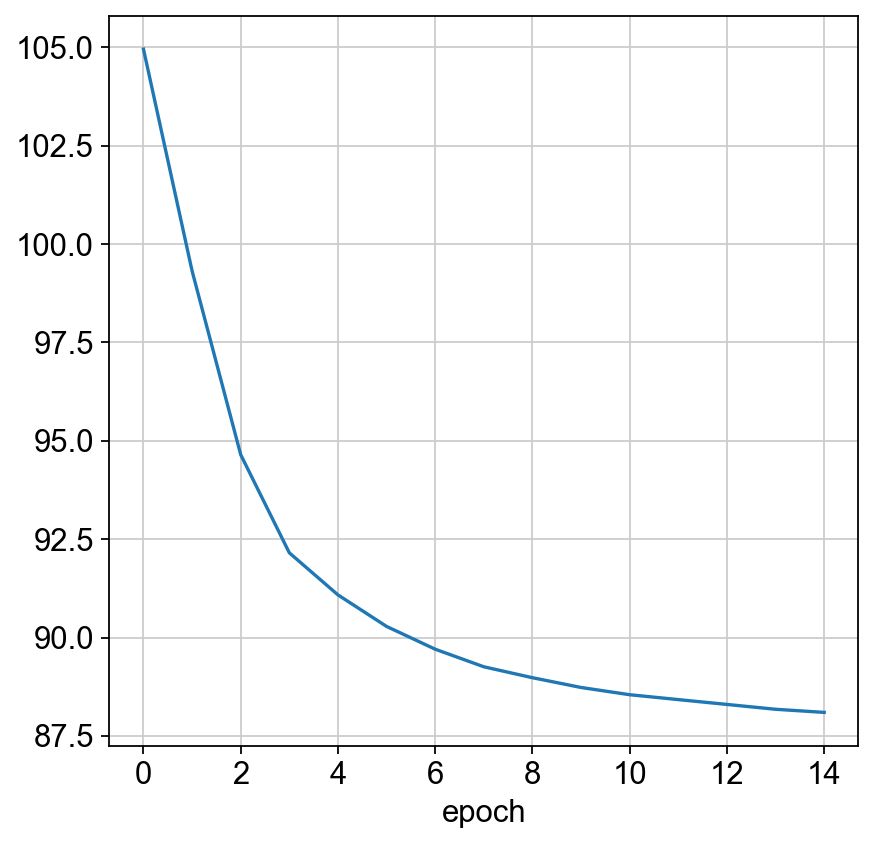

In [40]:
import pandas as pd
history = pd.read_csv(f"{trainer.logger.log_dir}/metrics.csv", index_col="epoch")
history = history.drop("step", axis=1)
#axe=history["kl_loss"].plot.line()
#axe=history["nb_loss"].plot.line()
axe=history["nb_loss"].plot.line()
#axe.set_xlim()
#axe.set_ylim(3, 4)
#axe.set_ylim(85, 90)
axe

In [ ]:
def print_CSVlogger(trainer, metric):
    history = pd.read_csv(f"{trainer.logger.log_dir}/metrics.csv", index_col="epoch")
    axe=history["metric"].plot.line()
    return axe

In [302]:
def print_pca(df:pd.DataFrame, cluster=None, palette=None, size=10, alpha=0.3):
    pca = PCA(n_components=2)
    pca_df= pd.DataFrame(pca.fit_transform(df), columns=["pca_1", "pca_2"], index=df.index)
    sns.jointplot(data=pca_df, x="pca_1", y="pca_2", hue=cluster, alpha=alpha, palette=palette, height=size)
    return pca_df


CD14+ Monocyte
CD19+ B
CD34+
CD4+ T Helper2
CD4+/CD25 T Reg
CD4+/CD45RA+/CD25- Naive T
CD4+/CD45RO+ Memory
CD56+ NK
CD8+ Cytotoxic T
CD8+/CD45RA+ Naive Cytotoxic
Dendritic


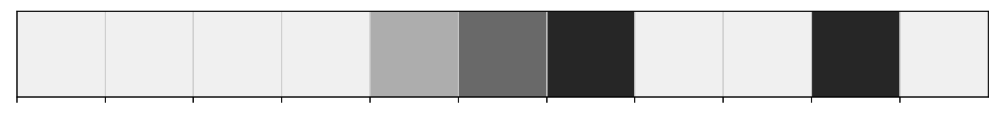

In [365]:
celltype=adata_hv.obs["celltype"].cat.categories
groups = celltype.groupby(adata_hv.obs["celltype"].cat.categories.str[:4])
cluster_palette = sns.color_palette(n_colors=len(groups))
subcluster_palette = []
i = 0
for color, group in zip(cluster_palette.as_hex(), groups):
    for c, g in zip(sns.light_palette(color,len(groups[group])), groups[group]):
        subcluster_palette.append(c)
        print(g)

sns.set_palette(subcluster_palette)
sns.palplot(sns.color_palette())

In [322]:
cluster = pd.unique(adata_hv.obs["celltype"].cat.categories.str[:4])
cluster_palette = sns.color_palette(n_colors=len(cluster))
for color in cluster_palette.as_hex():
    print(color)

,pca_1,pca_2
barcodes,,
AAACATACACCCAA-1,0.919813,-0.793833
AAACATACCCCTCA-1,-1.966750,0.671477
AAACATACCGGAGA-1,0.335443,-0.647185
AAACATACTAACCG-1,0.141220,1.085254
AAACATACTCTTCA-1,-0.282645,-0.978426
...,...,...
TTTGCATGAGCCTA-8,-1.313888,0.562759
TTTGCATGCTAGCA-8,-1.348036,0.663952
TTTGCATGCTGCAA-8,1.362965,-1.318615


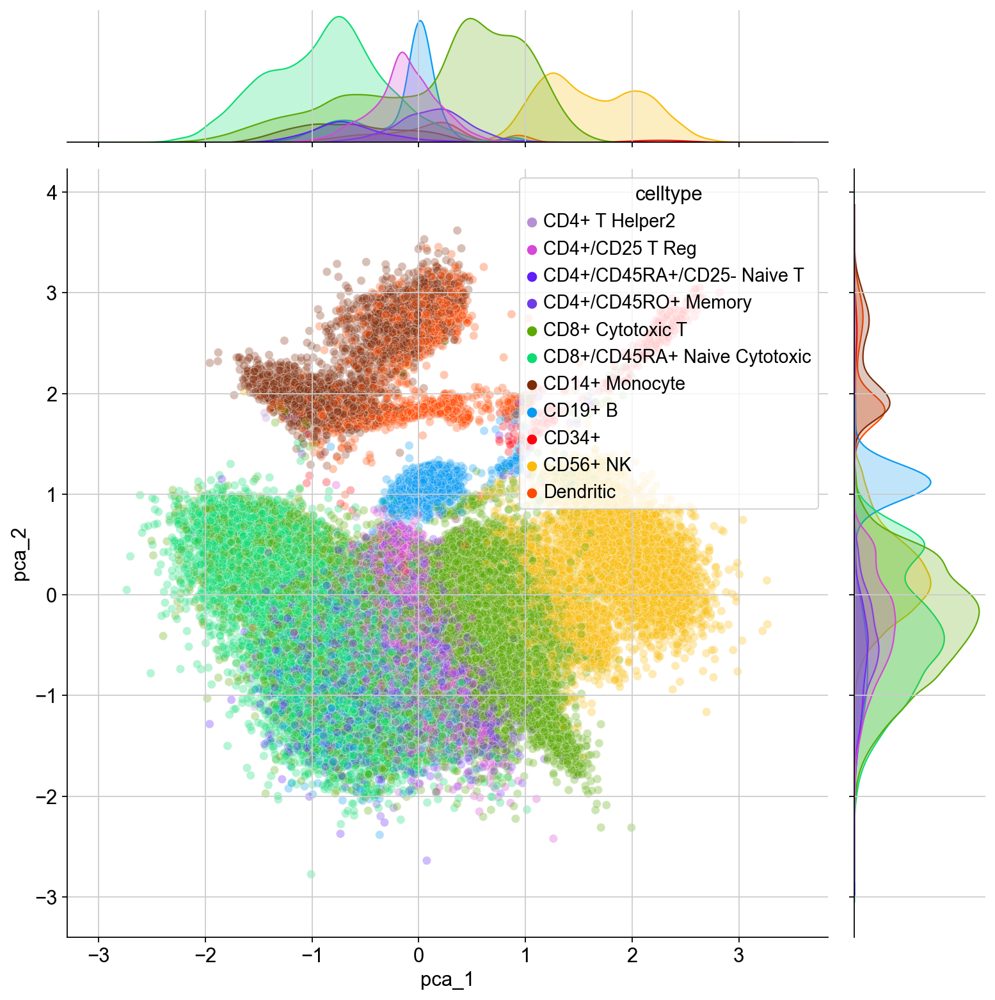

In [306]:
print_pca(adata_hv.obsm["latent"], adata.obs["celltype"], palette=palette)

In [102]:
dl = DataLoader(ds, batch_size=128)
predictions = trainer.predict(autoencoder, dl)
m = np.vstack([batch[0] for batch in predictions]).squeeze(1)


c:\Users\guido\Desktop\tesi\model-scvi\ENV\lib\site-packages\pytorch_lightning\trainer\data_loading.py:132: UserWarning: The dataloader, predict_dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(


Predicting: 138it [00:00, ?it/s]

(68579, 12)

In [114]:
from sklearn.decomposition import PCA
adata_hv.obsm["latent"] = pd.DataFrame(m, columns=[f"latent{i+1}" for i in np.arange(12)], index=adata_hv.obs_names)
pca = PCA(n_components=2)
pca_df= pd.DataFrame(pca.fit_transform(adata_hv.obsm["latent"] ), columns=["pca_1", "pca_2"], index=adata_hv.obs_names)
pca_df

,pca_1,pca_2
barcodes,,
AAACATACACCCAA-1,0.919823,-0.793846
AAACATACCCCTCA-1,-1.966748,0.671468
AAACATACCGGAGA-1,0.335443,-0.647185
AAACATACTAACCG-1,0.141219,1.085254
AAACATACTCTTCA-1,-0.282645,-0.978427
...,...,...
TTTGCATGAGCCTA-8,-1.313888,0.562759
TTTGCATGCTAGCA-8,-1.348036,0.663952
TTTGCATGCTGCAA-8,1.362965,-1.318615


In [289]:
#cl1=adata_hv.obs["celltype"].str[:4]
cluster_cell=adata_hv.obs["celltype"]
len(cluster_cell.cat.categories)

11

<AxesSubplot: >

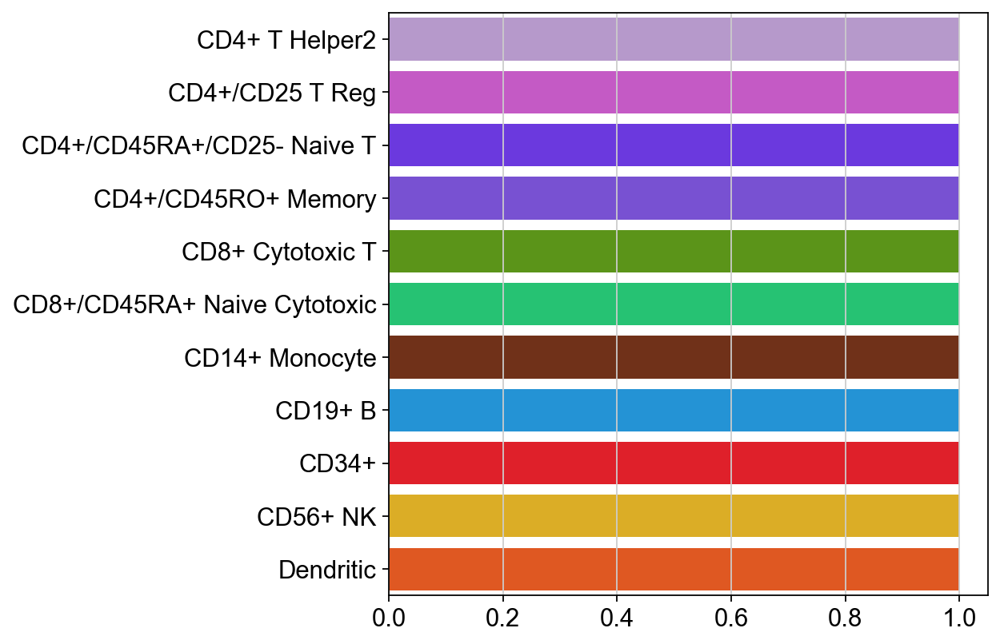

In [298]:
color = ["#b790d4", "#d648d7", "#601ef9", "#703be7", #910951 #purple
          "#5ca904", "#0cdc73", #green
          "#7f2b0a", #brown
          "#069af3", #azure
          "#ff000d", #red
          "#f9bc08", #yellow
          "#fe4b03",] #orange
          #"#23c48b"] #greenbllue
palette = sns.color_palette(color)
sns.barplot(x=[1]*11, y=cluster_cell.cat.categories, orient="h", palette=palette,)

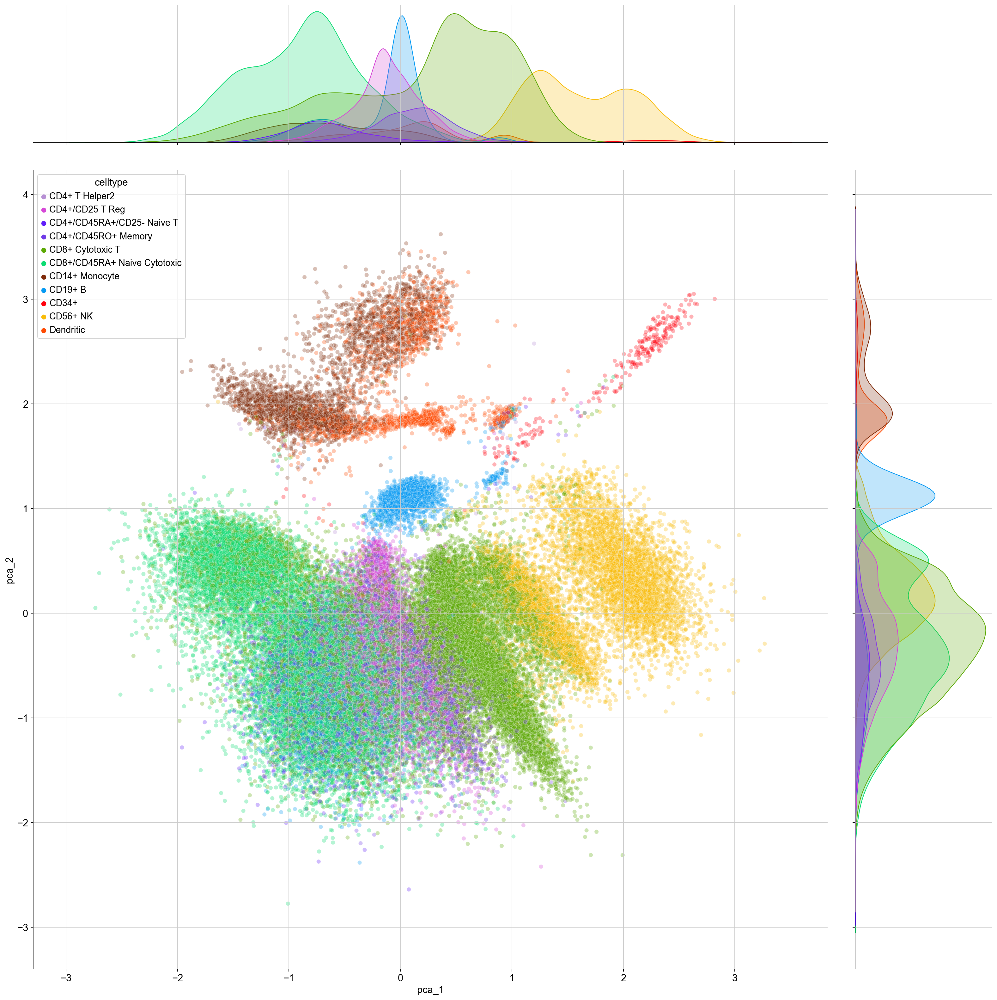

In [300]:
sns.jointplot(data=pca_df, x="pca_1", y="pca_2", hue=cluster_cell, alpha=0.3, palette=palette, height=10)

<AxesSubplot: xlabel='pca_1', ylabel='pca_2'>

c:\Users\guido\Desktop\tesi\model-scvi\ENV\lib\site-packages\IPython\core\events.py:89: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


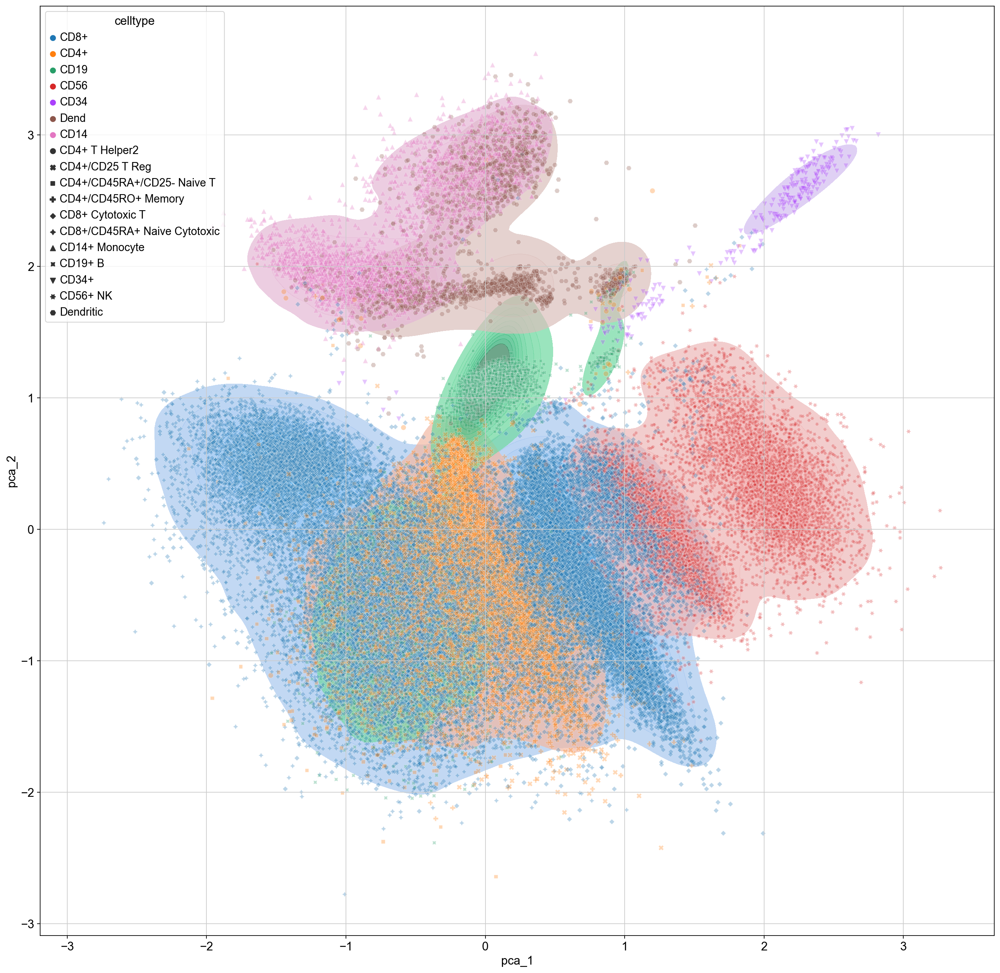

In [178]:
fig, ax = plt.subplots(figsize=(20, 20))
sns.kdeplot(data=pca_df, x="pca_1", y="pca_2", hue=cl1, alpha=0.7, ax=ax, fill=True)
sns.scatterplot(data=pca_df, x="pca_1", y="pca_2", hue=cl1, alpha=0.3, ax=ax)

<AxesSubplot: xlabel='pca_1', ylabel='pca_2'>

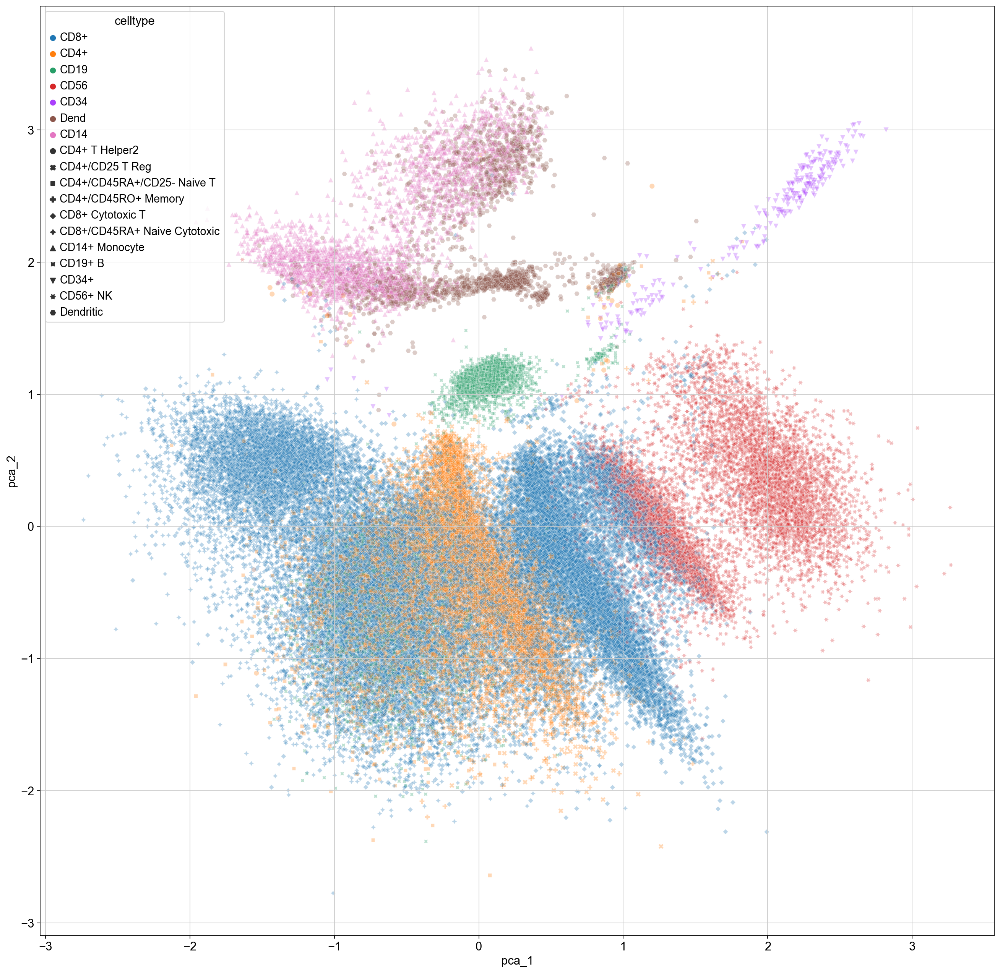

In [174]:
fig, ax = plt.subplots(figsize=(20, 20))
sns.scatterplot(data=pca_df, x="pca_1", y="pca_2", hue=cl1, style=cl2, alpha=0.3, ax=ax)

IndexError: index 2 is out of bounds for axis 0 with size 2

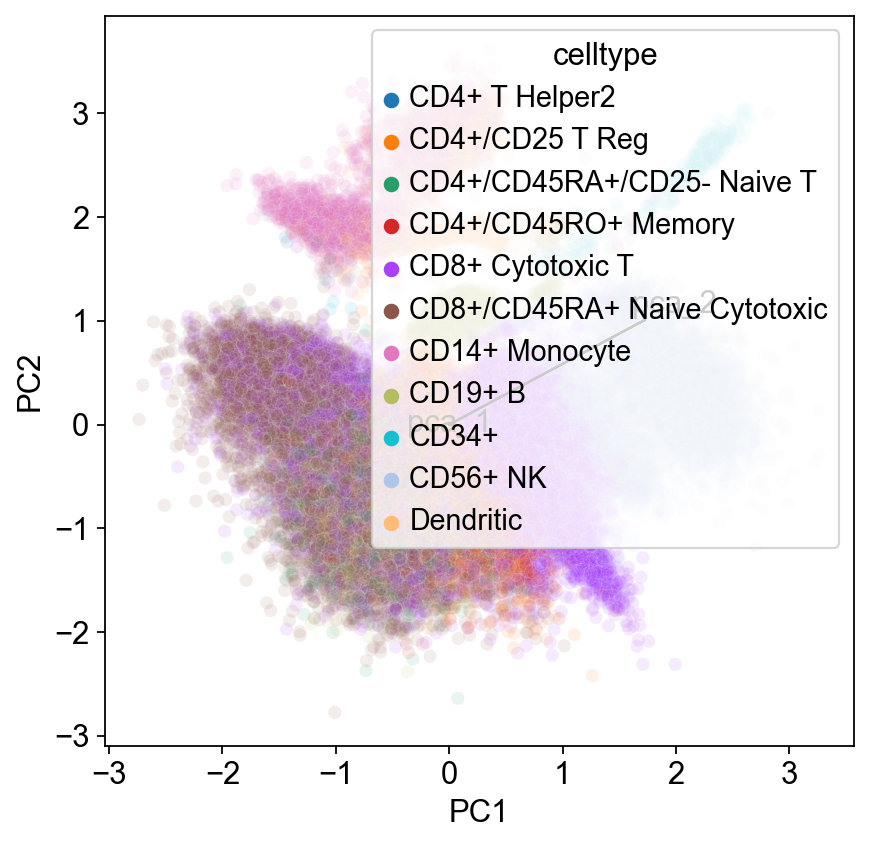

In [138]:
import matplotlib.pyplot as plt

def myplot(cluster_score,coeff,labels=None, cell_cluster=None):
    n = coeff.shape[0]

    sns.scatterplot(x=cluster_score["pca_1"], y=cluster_score["pca_2"], hue=cell_cluster,alpha=0.1,)
    for i in range(n):
        plt.arrow(0, 0, coeff[i,0], coeff[i,1],color = 'k')
        if labels is None:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, "Var"+str(i+1), color = 'k', ha = 'center', va = 'center')
        else:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, labels[i], color = 'k', ha = 'center', va = 'center')

plt.xlabel(f"PC{1}")
plt.ylabel(f"PC{2}")
plt.grid()

#Call the function. 
myplot(pca_df, pca.components_.T*2, pca_df.columns, adata.obs["celltype"]) 
plt.show()

In [ ]:
import matplotlib.pyplot as plt

def myplot(cluster_score,coeff,labels=None, cell_cluster=None):
    n = coeff.shape[0]

    sns.scatterplot(x=cluster_score["pca_1"], y=cluster_score["pca_2"], hue=cell_cluster,alpha=0.1,)
    for i in range(n):
        plt.arrow(0, 0, coeff[i,0], coeff[i,1],color = 'k')
        if labels is None:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, "Var"+str(i+1), color = 'k', ha = 'center', va = 'center')
        else:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, labels[i], color = 'k', ha = 'center', va = 'center')

plt.xlabel(f"PC{1}")
plt.ylabel(f"PC{2}")
plt.grid()

#Call the function. 
myplot(pca_df, pca.components_.T*2, pca_df.columns, adata.obs["celltype"]) 
plt.show()

In [ ]:
import matplotlib.pyplot as plt

def myplot(cluster_score,coeff,labels=None, cell_cluster=None):
    n = coeff.shape[0]

    sns.scatterplot(x=cluster_score["pca_1"], y=cluster_score["pca_2"], hue=cell_cluster,alpha=0.1,)
    for i in range(n):
        plt.arrow(0, 0, coeff[i,0], coeff[i,1],color = 'k')
        if labels is None:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, "Var"+str(i+1), color = 'k', ha = 'center', va = 'center')
        else:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, labels[i], color = 'k', ha = 'center', va = 'center')

plt.xlabel(f"PC{1}")
plt.ylabel(f"PC{2}")
plt.grid()

#Call the function. 
myplot(pca_df, pca.components_.T*2, pca_df.columns, adata.obs["celltype"]) 
plt.show()

In [111]:


#pca_vl_pred_x= pd.DataFrame(pca.transform(vl_pred_x), columns=["pca_1", "pca_2"], index=ml_pred.index)
#s = np.sqrt((pca_vl_pred_x.min()pca_vl_pred_x.iloc[:, 0] + pca_vl_pred_x.iloc[:, 1])/2)



,latent1,latent2,latent3,latent4,latent5,latent6,latent7,latent8,latent9,latent10,latent11,latent12
barcodes,,,,,,,,,,,,
AAACATACACCCAA-1,-0.009626,0.399129,0.019129,-0.002994,-1.140905,0.016849,-0.002984,0.016114,0.002859,0.012523,-0.004244,0.007617
AAACATACCCCTCA-1,-0.016446,-1.353518,0.027355,-0.021831,1.580377,-0.008753,-0.012768,-0.004307,0.002048,-0.035222,-0.059260,-0.003621
AAACATACCGGAGA-1,-0.040638,-0.031298,-0.029126,0.032273,-0.719149,0.019654,0.007962,0.022494,0.034454,0.021634,0.030686,-0.006817
AAACATACTAACCG-1,-0.039009,0.674871,0.000905,-0.009403,0.873407,-0.026862,0.010798,-0.011052,0.037497,-0.042747,-0.021494,0.031416
AAACATACTCTTCA-1,-0.005588,-0.732050,-0.003751,-0.005635,-0.694018,0.007392,-0.015982,-0.016209,0.001647,-0.002151,-0.016977,-0.010308
...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGCATGAGCCTA-8,0.002400,-0.844700,0.014196,-0.029679,1.157039,-0.003388,0.004928,-0.001775,-0.012453,-0.025915,-0.004280,-0.008327
TTTGCATGCTAGCA-8,-0.004756,-0.823375,0.015640,-0.023232,1.261428,-0.017487,-0.006932,-0.023170,0.002186,-0.013615,-0.007302,0.001928
TTTGCATGCTGCAA-8,0.007906,0.517405,0.001961,0.008812,-1.817234,0.027616,-0.039796,0.011138,-0.027615,0.020259,0.029181,-0.032779


In [37]:
import seaborn as sns

In [44]:
df = pd.DataFrame(qz_m.detach().numpy().reshape(500,-1))
df.columns = [f"latent{i}" for i in np.arange(12)]
df.index = adata_hv.obs_names[:500]

In [47]:
df["celltype"] = adata_hv.obs["celltype"][:500]

,latent0,latent1,celltype
barcodes,,,
AAACATACACCCAA-1,-0.002792,-0.010143,CD8+ Cytotoxic T
AAACATACCCCTCA-1,-0.013648,0.003631,CD8+/CD45RA+ Naive Cytotoxic
AAACATACCGGAGA-1,0.015255,-0.017189,CD4+/CD45RO+ Memory
AAACATACTAACCG-1,-0.036429,-0.004400,CD19+ B
AAACATACTCTTCA-1,-0.006087,-0.013810,CD4+/CD25 T Reg
...,...,...,...
AAGTTCCTTGTAGC-1,-0.001062,-0.003027,CD8+/CD45RA+ Naive Cytotoxic
AATAACACAAACAG-1,-0.000325,0.024249,CD8+ Cytotoxic T
AATAACACACACCA-1,0.004510,-0.018025,CD4+/CD45RA+/CD25- Naive T


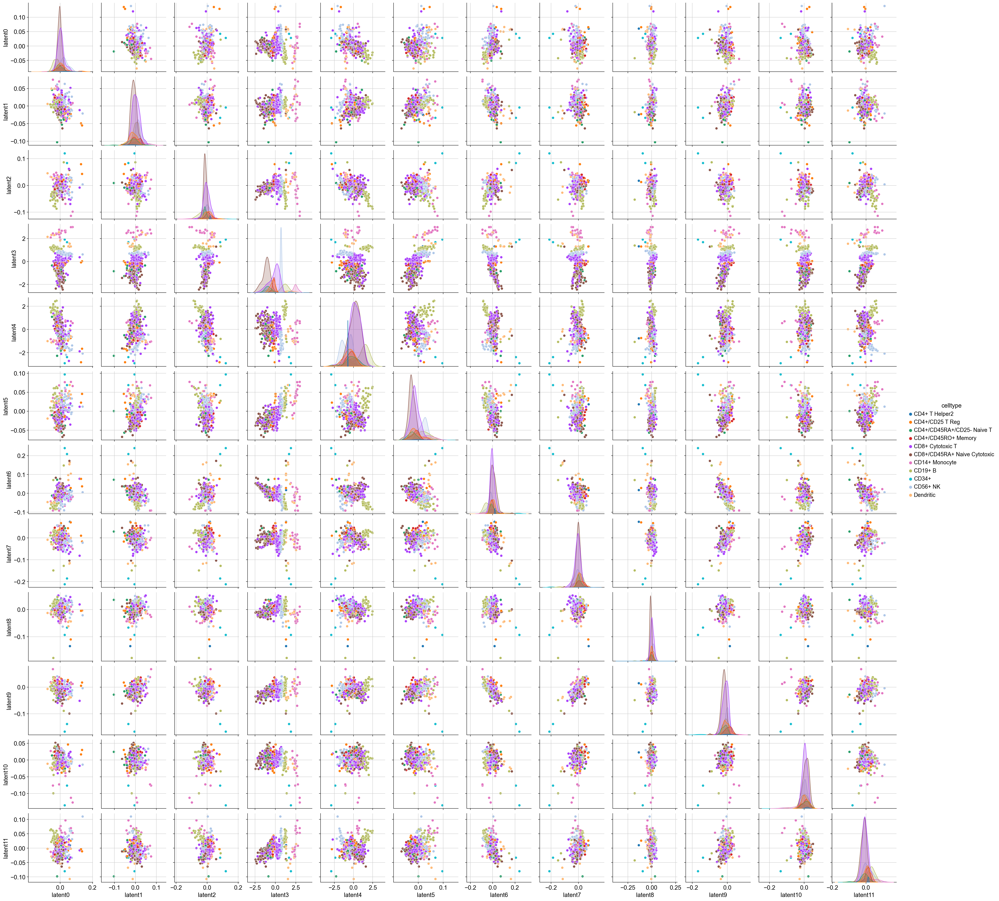

In [64]:
sns.pairplot(df, hue="celltype")